In [1]:
import scanpy as sc
import scarches as sca
import numpy as np
from scarches.plotting.terms_scores import plot_abs_bfs_key

Global seed set to 0


In [2]:
sc.set_figure_params(figsize=(6, 6))
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sb

font = {'family' : 'Arial',
        'size'   : 14}

matplotlib.rc('font', **font)
matplotlib.rc('ytick', labelsize=14)
matplotlib.rc('xtick', labelsize=14)
matplotlib.rcParams["figure.dpi"] = 200

### Pbmc Kang

In [3]:
adata = sc.read('kang_pbmc_integrated.h5ad')

In [4]:
adata.obs['condition_merged'] = adata.obs['condition'].tolist()
adata.obs['condition_merged'][adata.obs['condition_merged'].astype(str)=='nan'] = 'control'
adata.strings_to_categoricals()

<ipython-input-4-dcc145970c64>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs['condition_merged'][adata.obs['condition_merged'].astype(str)=='nan'] = 'control'


In [5]:
intr_cvae = sca.models.TRVAE.load('q_intr_cvae_nolog_alpha_kl_0_5_0_1_sd_2020', adata)


INITIALIZING NEW NETWORK..............
Encoder Architecture:
	Input Layer in, out and cond: 1972 256 5
	Hidden Layer 1 in/out: 256 256
	Hidden Layer 2 in/out: 256 256
	Mean/Var Layer in/out: 256 282
Decoder Architecture:
	Cond layer in, ext, ext_m, cond, out and :  282 0 0 5 1972
	with hard mask.


In [6]:
directions = intr_cvae._latent_directions(method="sum")

In [7]:
adata.obsm['X_cvae'] *= directions[intr_cvae.model.decoder.nonzero_terms()]

In [8]:
scores_cond = intr_cvae.latent_enrich('condition_merged', comparison="control", directions=directions, adata=adata, n_perm=7000)

In [9]:
scores_ct = intr_cvae.latent_enrich('cell_type_joint', directions=directions, n_perm=7000, adata=adata)

In [10]:
adata.uns['active_terms'] = adata.uns['full_terms'][intr_cvae.model.decoder.nonzero_terms()]

In [11]:
adata_ct = adata[adata.obs.cell_type_joint == 'CD14+ Monocytes']

In [12]:
scores_c_ct = intr_cvae.latent_enrich('condition_merged', comparison="control", directions=directions, adata=adata_ct, n_perm=10000)

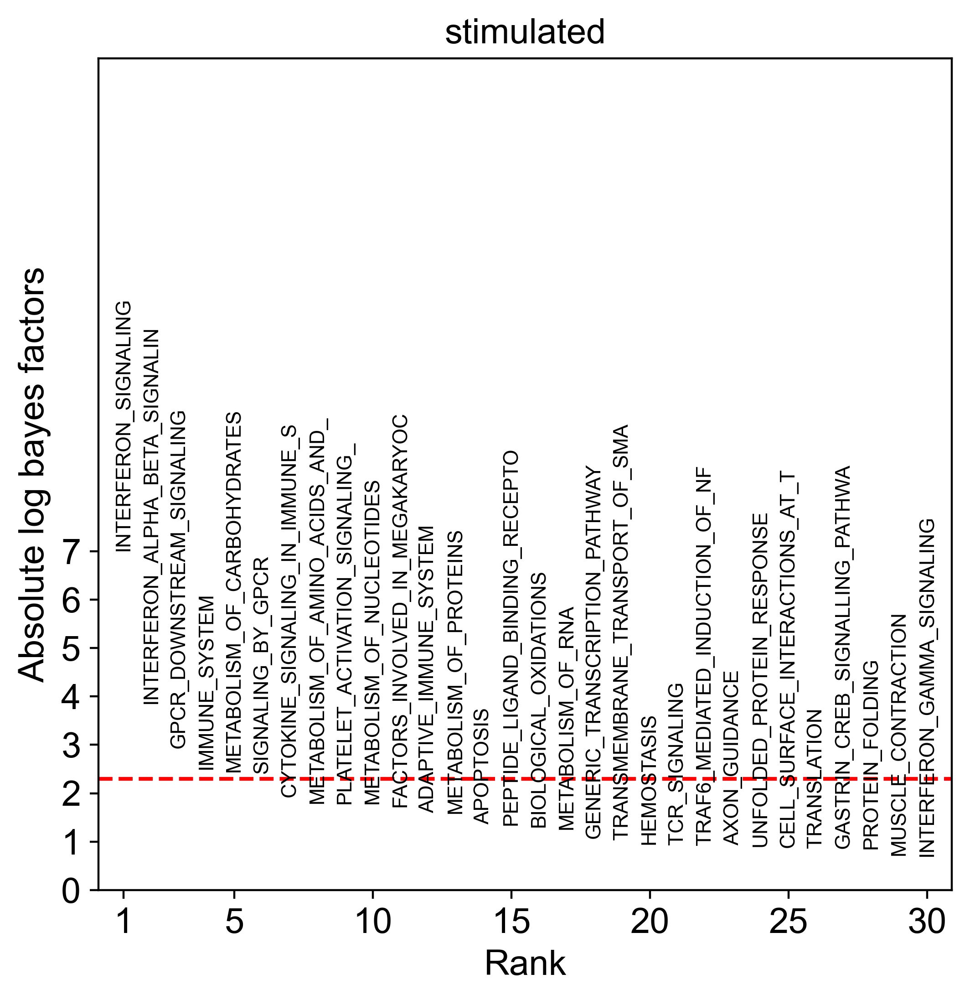

In [13]:
axs = plot_abs_bfs_key(scores_c_ct, adata.uns['terms'], 'stimulated', yt_step=1, scale_y=2.45)

In [14]:
adata_ct.uns['active_terms'] = adata.uns['terms'][intr_cvae.model.decoder.nonzero_terms()]

C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\compat\_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


In [15]:
def filter_set_scores(scores, adata, filter_v=2.31):
    for k in scores:
        print(k)
        mask = np.abs(scores[k]['bf']) > filter_v
        s = sum(mask)
        if s > 0:
            sort = np.argsort(np.abs(scores[k]['bf'])[mask])[::-1]
            enriched_terms = adata.uns['terms'][mask][sort]
            
            print(enriched_terms)
            print(scores[k]['bf'][mask][sort])
            
            for term in enriched_terms:
                adata.obs[term] = adata.obsm['X_cvae'][:, adata.uns['active_terms'] == term]

In [16]:
filter_set_scores(scores_c_ct, adata_ct, filter_v=1)

stimulated
['INTERFERON_SIGNALING' 'INTERFERON_ALPHA_BETA_SIGNALIN'
 'GPCR_DOWNSTREAM_SIGNALING' 'IMMUNE_SYSTEM' 'METABOLISM_OF_CARBOHYDRATES'
 'SIGNALING_BY_GPCR' 'CYTOKINE_SIGNALING_IN_IMMUNE_S'
 'METABOLISM_OF_AMINO_ACIDS_AND_' 'PLATELET_ACTIVATION_SIGNALING_'
 'METABOLISM_OF_NUCLEOTIDES' 'FACTORS_INVOLVED_IN_MEGAKARYOC'
 'ADAPTIVE_IMMUNE_SYSTEM' 'METABOLISM_OF_PROTEINS' 'APOPTOSIS'
 'PEPTIDE_LIGAND_BINDING_RECEPTO' 'BIOLOGICAL_OXIDATIONS'
 'METABOLISM_OF_RNA' 'GENERIC_TRANSCRIPTION_PATHWAY'
 'TRANSMEMBRANE_TRANSPORT_OF_SMA']
[ 7.01  3.86  2.93 -2.5  -2.44  2.42 -1.93  1.8  -1.78 -1.78 -1.72 -1.59
 -1.58 -1.36 -1.34 -1.31  1.25 -1.07  1.04]


In [17]:
#check_terms = ['SIGNALING_BY_GPCR', 'CLASS_A1_RHODOPSIN_LIKE_RECEPT', 'IMMUNE_SYSTEM',
#               'RNA_POL_I_RNA_POL_III_AND_MITO', 'METABOLISM_OF_CARBOHYDRATES',
#               'CYTOKINE_SIGNALING_IN_IMMUNE_S', 'APOPTOTIC_EXECUTION_PHASE',
#               'METABOLISM_OF_NUCLEOTIDES', 'BIOLOGICAL_OXIDATIONS',
#               'INTERFERON_GAMMA_SIGNALING']

In [18]:
check_terms = ['INTERFERON_SIGNALING', 'INTERFERON_ALPHA_BETA_SIGNALIN',
 'GPCR_DOWNSTREAM_SIGNALING', 'IMMUNE_SYSTEM', 'SIGNALING_BY_GPCR',
 'METABOLISM_OF_CARBOHYDRATES', 'CYTOKINE_SIGNALING_IN_IMMUNE_S',
 'PLATELET_ACTIVATION_SIGNALING_', 'METABOLISM_OF_AMINO_ACIDS_AND_',
 'METABOLISM_OF_NUCLEOTIDES']

In [19]:
intr_cvae.terms_genes()['IMMUNE_SYSTEM']

['ISG15',
 'SPSB1',
 'PIK3CD',
 'FBXO44',
 'FBXO6',
 'CASP9',
 'UBR4',
 'EIF4G3',
 'C1QA',
 'C1QC',
 'C1QB',
 'RPS6KA1',
 'IFI6',
 'PTAFR',
 'LCK',
 'CDC20',
 'PIK3R3',
 'JUN',
 'JAK1',
 'PRKACB',
 'BCL10',
 'GBP1',
 'GBP2',
 'GBP4',
 'GBP5',
 'CAPZA1',
 'SIKE1',
 'FCGR1B',
 'CD160',
 'TXNIP',
 'FCGR1A',
 'CTSS',
 'CTSK',
 'THEM4',
 'S100A12',
 'IL6R',
 'UBE2Q1',
 'ADAR',
 'SHC1',
 'AIM2',
 'FCGR3A',
 'FCGR2B',
 'CD247',
 'SELL',
 'KIFAP3',
 'KLHL20',
 'NCF2',
 'PTPRC',
 'IKBKE',
 'MAPKAPK2',
 'CD55',
 'CR1',
 'CD46',
 'PPP2R5A',
 'TLR5',
 'TRIM11',
 'AKT3',
 'NLRP3',
 'ADAM17',
 'KIF3C',
 'RASGRP3',
 'EIF2AK2',
 'SOS1',
 'PPM1B',
 'PSME4',
 'REL',
 'PELI1',
 'CD8A',
 'CD8B',
 'ACTR1B',
 'ZAP70',
 'RANBP2',
 'ANAPC1',
 'IL1B',
 'IL1RN',
 'TANK',
 'PSMD14',
 'IFIH1',
 'DYNC1I2',
 'UBE2E3',
 'ITGAV',
 'STAT1',
 'CASP10',
 'CASP8',
 'CD28',
 'CTLA4',
 'ICOS',
 'CREB1',
 'CUL3',
 'IRS1',
 'TRIP12',
 'PSMD1',
 'UBE2F',
 'PDCD1',
 'IL5RA',
 'VHL',
 'IRAK2',
 'ATG7',
 'RAF1',
 'NUP210',
 'UBE

In [20]:
idxs = [adata_ct.uns['active_terms'].tolist().index(t) for t in check_terms]

In [21]:
idxs

[193, 192, 129, 223, 88, 205, 229, 240, 75, 109]

In [22]:
adata_pl = sc.AnnData(X=adata.obsm['X_cvae'][:, idxs])

In [23]:
adata_pl.var_names = check_terms

In [24]:
adata_pl.obs['ct_cond'] = 'stub'

In [25]:
for i in range(adata.n_obs):
    adata_pl.obs['ct_cond'][i] = adata.obs['cell_type_joint'][i] + '_' + adata.obs['condition_merged'][i]

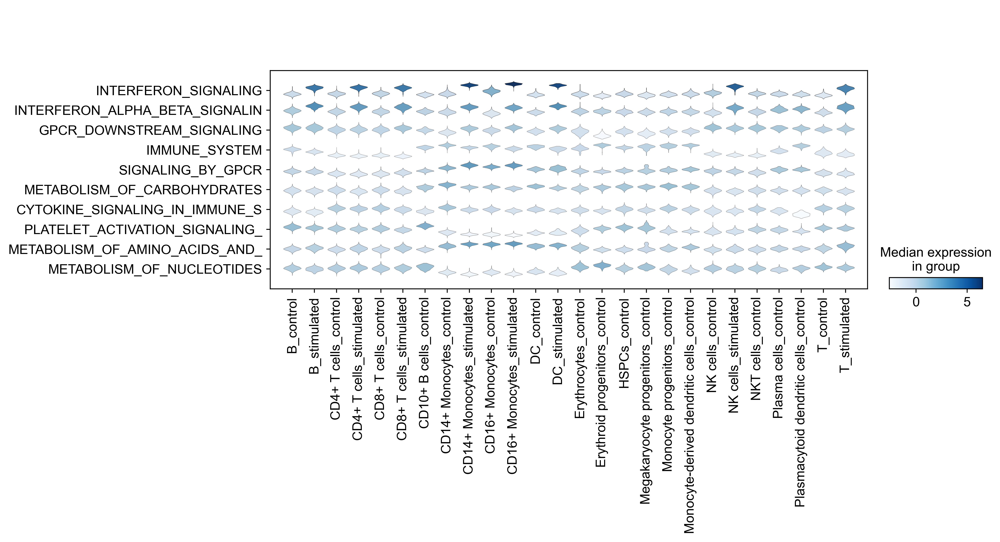

In [26]:
sc.pl.stacked_violin(adata_pl, var_names=check_terms, groupby='ct_cond', swap_axes=True)

In [44]:
query_ct = adata_pl[adata.obs.study == 'Kang'].obs.ct_cond.unique().tolist()

In [45]:
adata_pl_q = adata_pl[adata_pl.obs.ct_cond.isin(query_ct)]

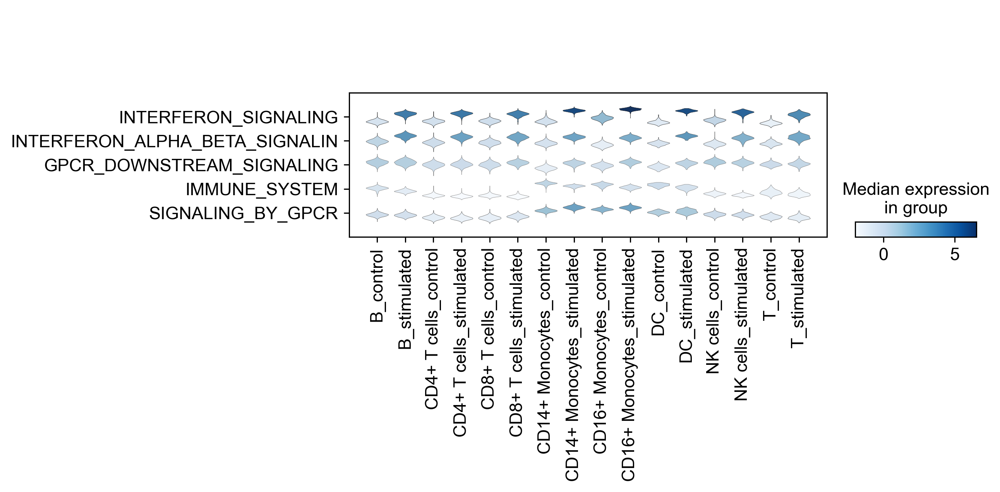

In [100]:
sc.pl.stacked_violin(adata_pl_q, var_names=check_terms[:5], groupby='ct_cond', swap_axes=True)

C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1236: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


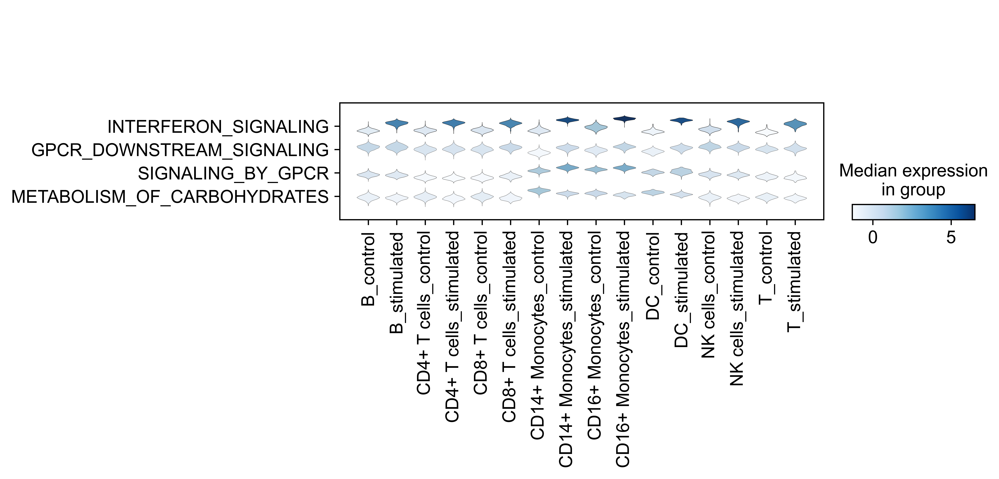

In [46]:
sc.pl.stacked_violin(adata_pl_q, var_names=['INTERFERON_SIGNALING', 'GPCR_DOWNSTREAM_SIGNALING', 'SIGNALING_BY_GPCR', 'METABOLISM_OF_CARBOHYDRATES'], groupby='ct_cond', swap_axes=True)

In [12]:
query_ct = adata.obs.cell_type_joint[adata.obs.batch_join == 'Kang (query)'].unique()

In [13]:
scores_ct_q = {k: v for k, v in scores_ct.items() if k in query_ct}

CD14+ Monocytes


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1230: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


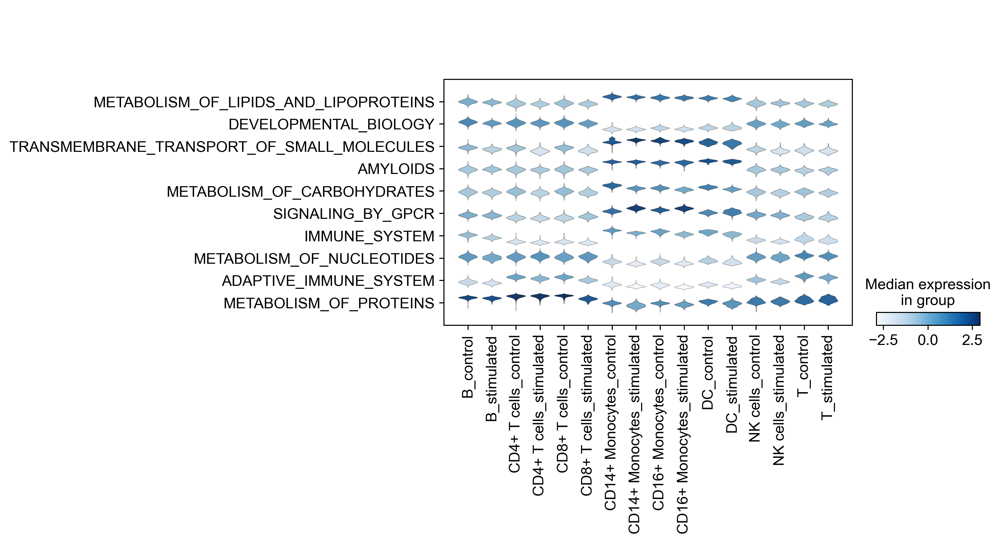

CD4+ T cells


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1230: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


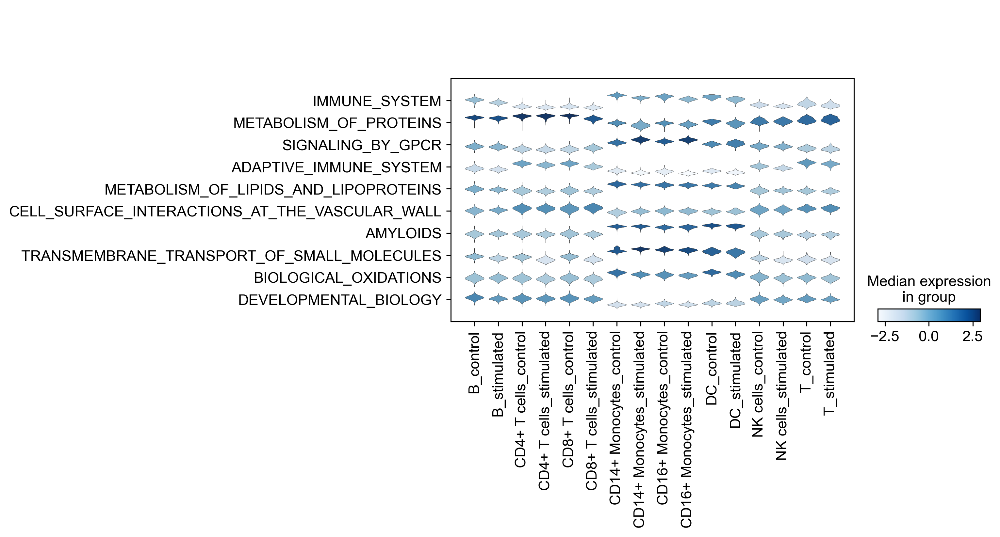

T


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1230: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


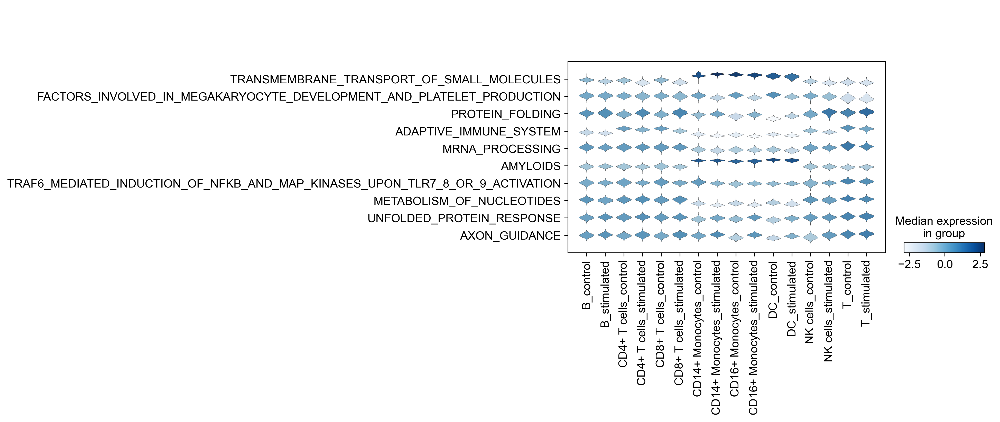

CD8+ T cells


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1230: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


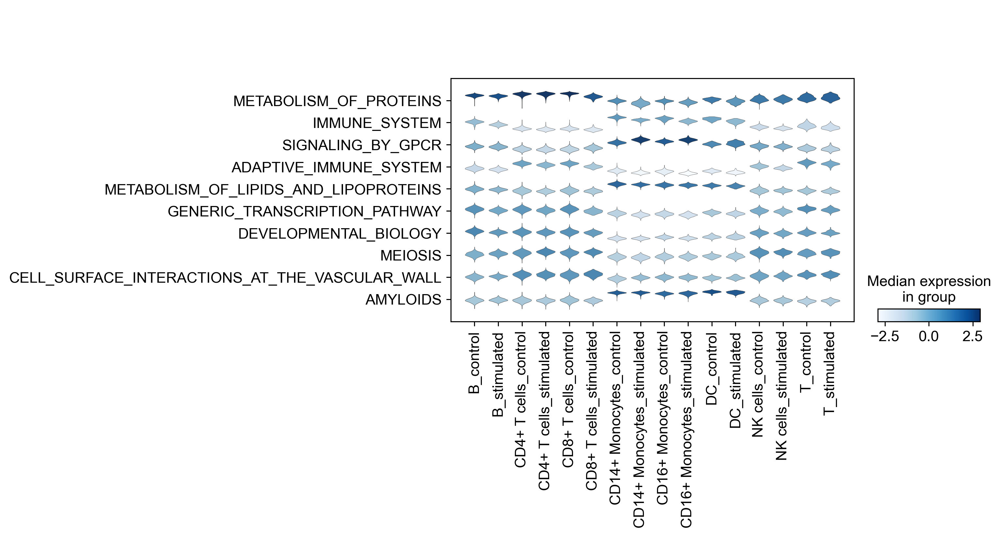

B


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1230: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


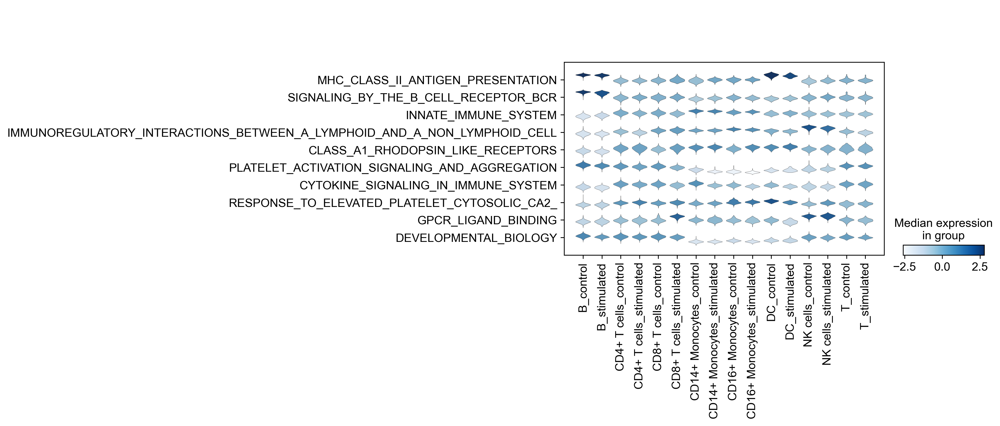

DC


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1230: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


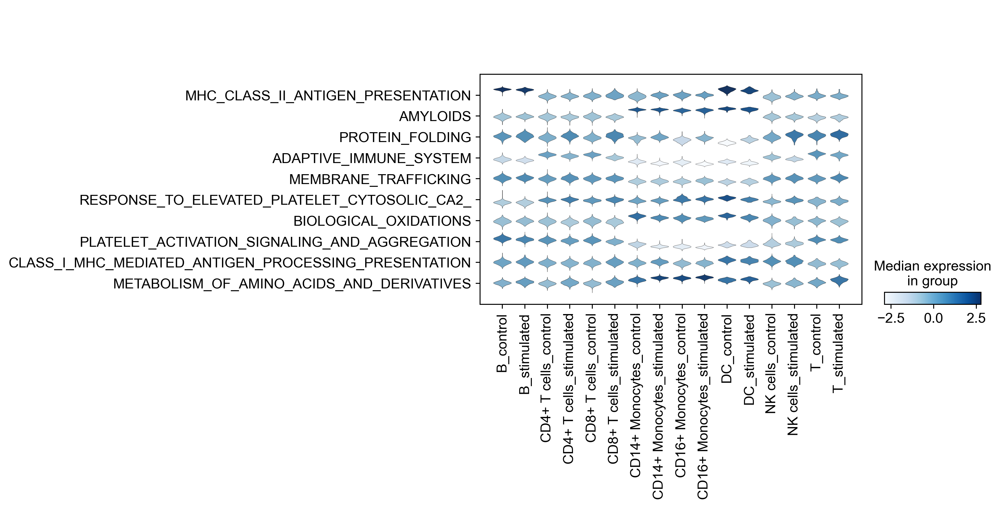

CD16+ Monocytes


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1230: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


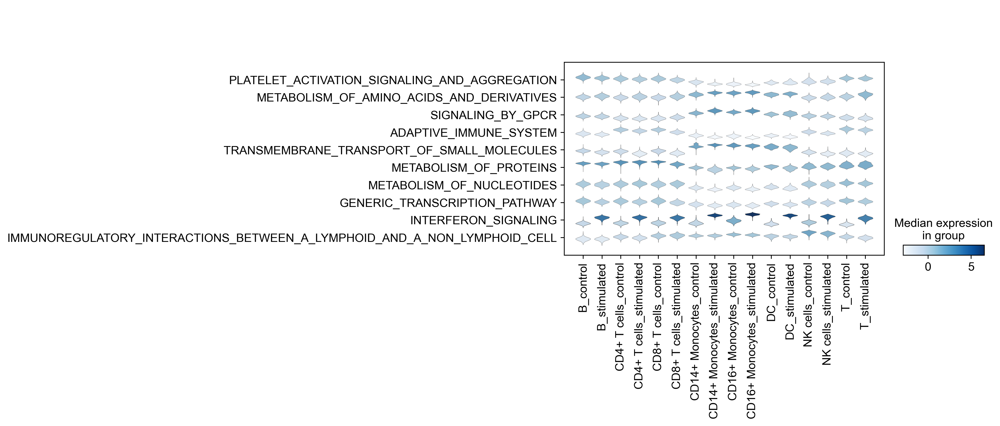

NK cells


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1230: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


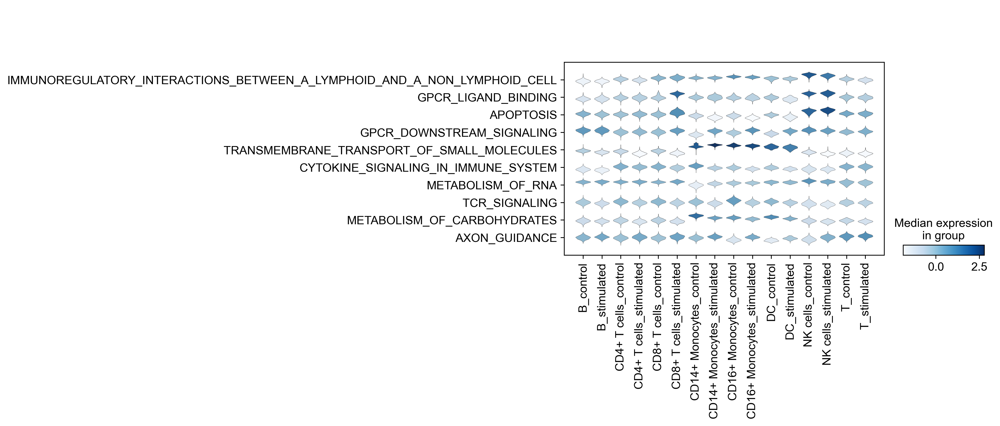

In [29]:
for ct in query_ct:
    print(ct)
    scores = scores_ct[ct]['bf']
    sort = np.argsort(np.abs(scores))[::-1]
    top_10_terms = adata.uns['full_terms'][sort][:10]
    idxs = [adata.uns['active_terms'].tolist().index(t) for t in top_10_terms]
    
    adata_pl = sc.AnnData(X=adata.obsm['X_cvae'][:, idxs])
    adata_pl.var_names = top_10_terms.tolist()
    adata_pl.obs['ct_cond'] = 'stub'
    for i in range(adata.n_obs):
        adata_pl.obs['ct_cond'][i] = adata.obs['cell_type_joint'][i] + '_' + adata.obs['condition_merged'][i]
    query_typs = adata_pl[adata.obs.study == 'Kang'].obs.ct_cond.unique().tolist()
    adata_pl_q = adata_pl[adata_pl.obs.ct_cond.isin(query_typs)]
    sc.pl.stacked_violin(adata_pl_q, var_names=top_10_terms, groupby='ct_cond', swap_axes=True)

In [14]:
adata.obs['condition_merged'] = adata.obs['condition_merged'].astype(str)
adata.obs['condition_merged'][adata.obs['condition_merged']=='stimulated'] = 'IFN-beta'

<ipython-input-14-fbfb3444e65f>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs['condition_merged'][adata.obs['condition_merged']=='stimulated'] = 'IFN-beta'


CD14+ Monocytes


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1236: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


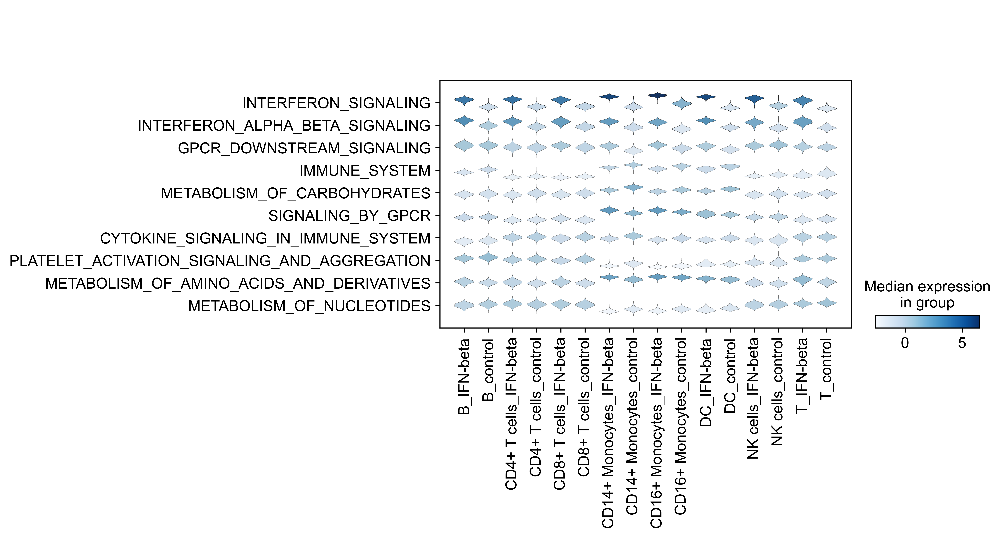

CD4+ T cells


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1236: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


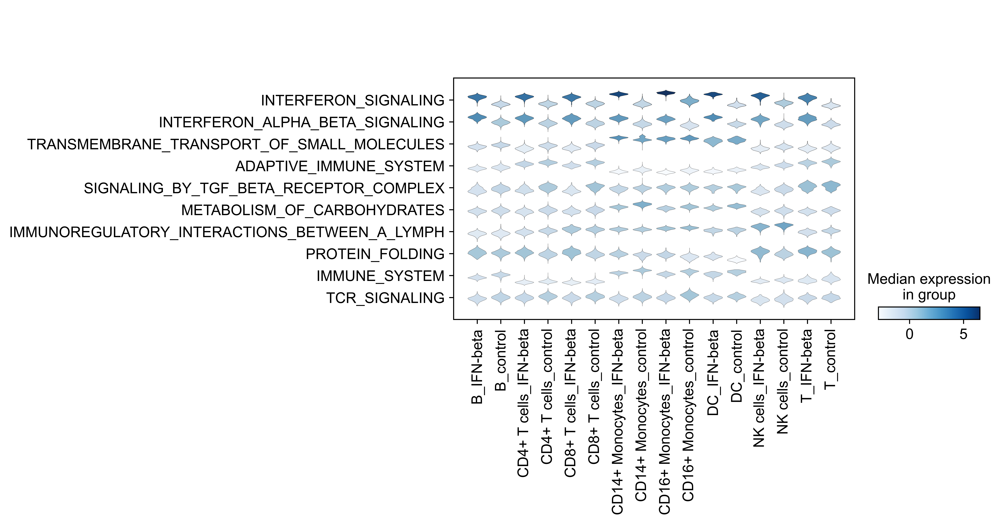

T


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1236: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


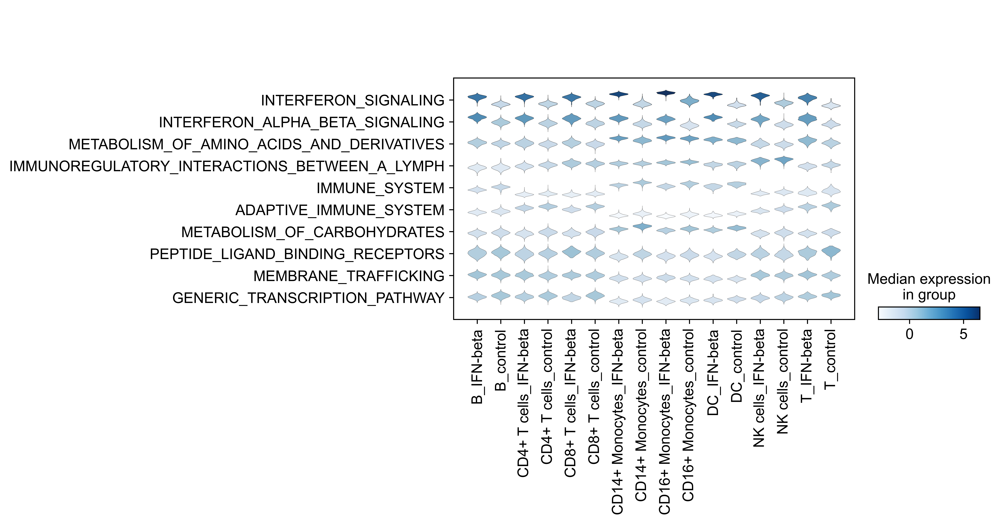

CD8+ T cells


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1236: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


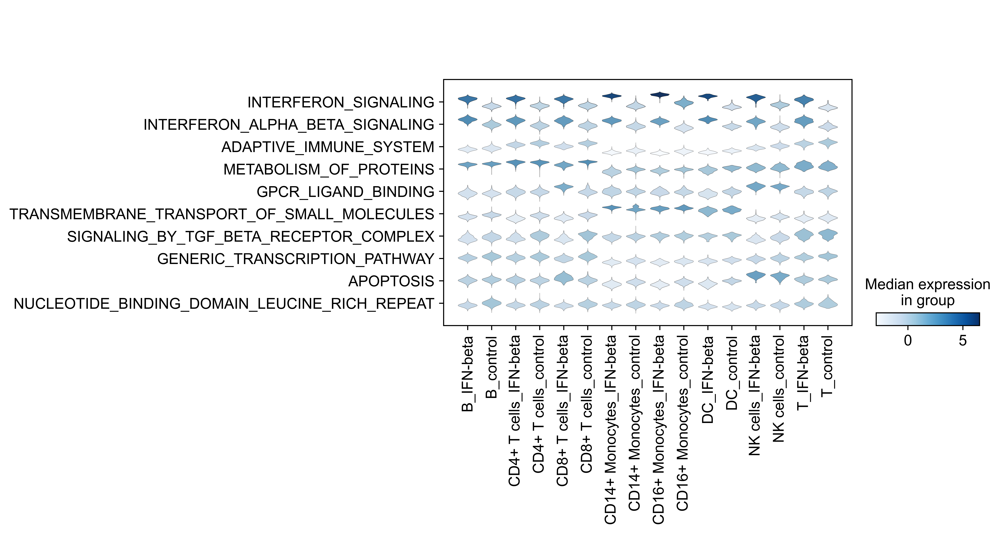

B


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1236: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


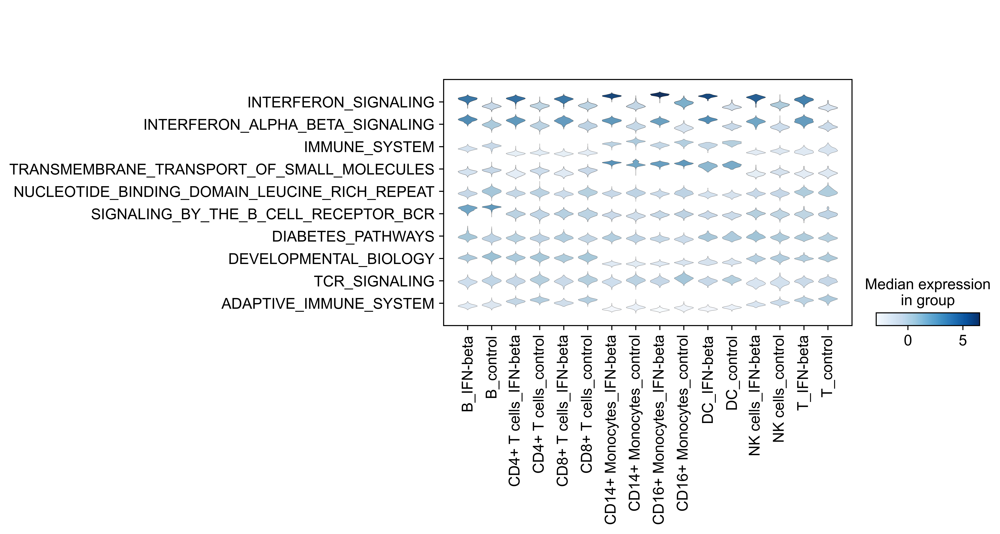

DC


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1236: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


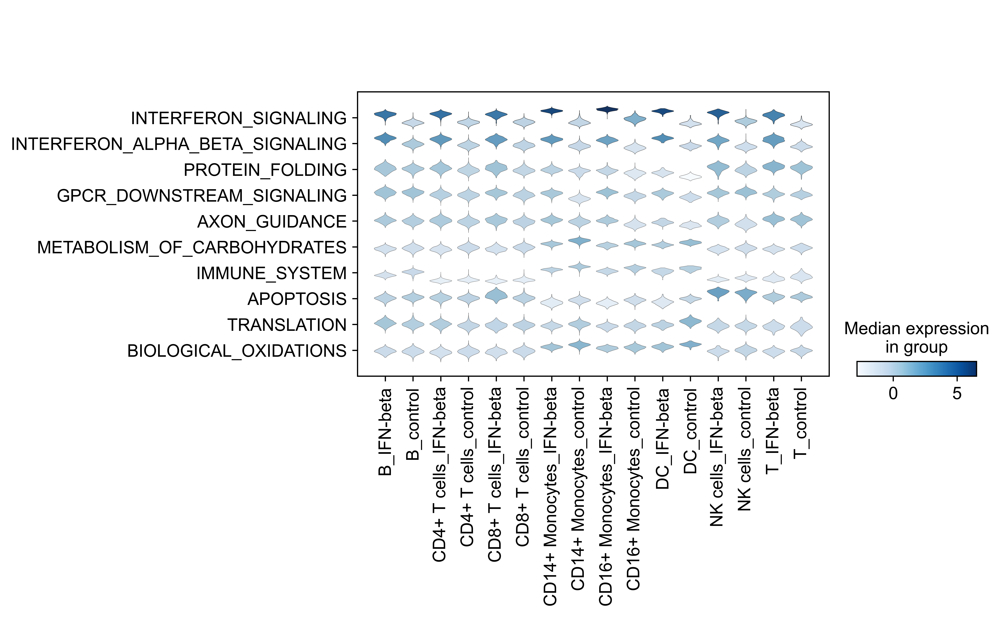

CD16+ Monocytes


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1236: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


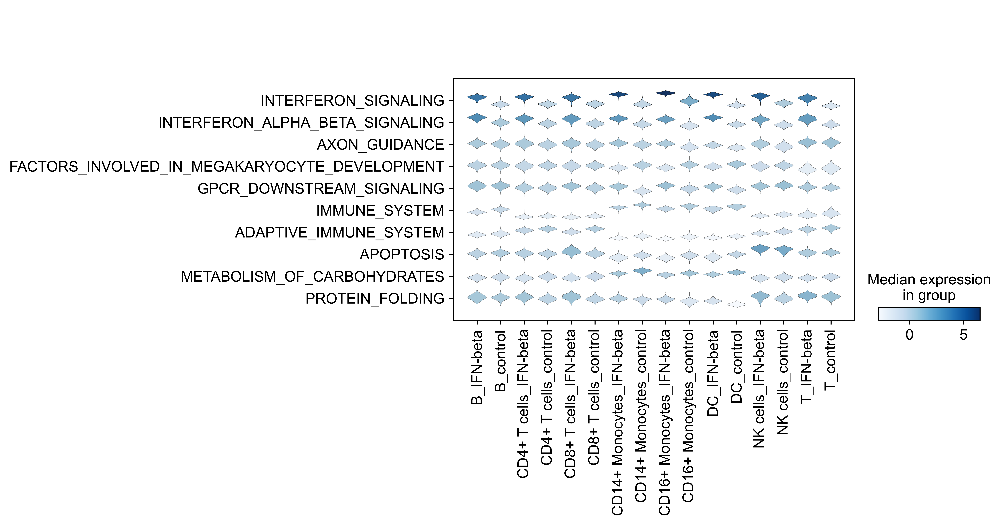

NK cells


C:\Users\sergei.rybakov\Apps\Miniconda3\envs\work38\lib\site-packages\anndata\_core\anndata.py:1236: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'ct_cond' as categorical


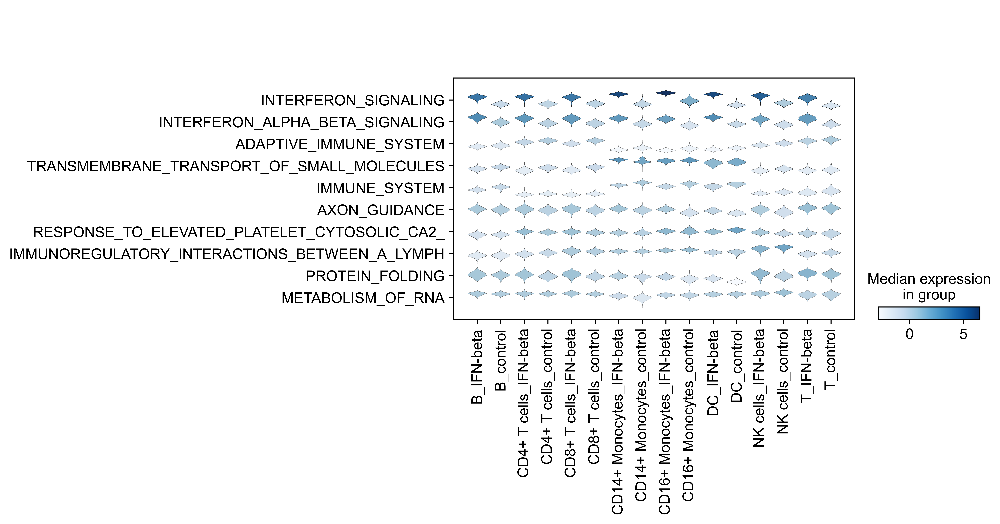

In [15]:
for ct in query_ct:
    print(ct)
    adata_ct = adata[adata.obs.cell_type_joint == ct]
    scores_c_ct = intr_cvae.latent_enrich('condition_merged', comparison="control", directions=directions, adata=adata_ct, n_perm=50000, exact=True)
    
    scores = scores_c_ct['IFN-beta']['bf']
    sort = np.argsort(np.abs(scores))[::-1]
    top_10_terms = adata.uns['full_terms'][sort][:10]
    idxs = [adata.uns['active_terms'].tolist().index(t) for t in top_10_terms]
    
    adata_pl = sc.AnnData(X=adata.obsm['X_cvae'][:, idxs])
    terms = [t[:45] for t in top_10_terms]
    adata_pl.var_names = terms
    adata_pl.obs['ct_cond'] = 'stub'
    for i in range(adata.n_obs):
        adata_pl.obs['ct_cond'][i] = adata.obs['cell_type_joint'][i] + '_' + adata.obs['condition_merged'][i]
    query_typs = adata_pl[adata.obs.study == 'Kang'].obs.ct_cond.unique().tolist()
    adata_pl_q = adata_pl[adata_pl.obs.ct_cond.isin(query_typs)]
    sc.pl.stacked_violin(adata_pl_q, var_names=terms, groupby='ct_cond', swap_axes=True)